### **Setting up the environment**

First, we bring in the important tools by importing packages. Setting a seed helps us to reproduce the same results later if needed. The global variables are like settings we can adjust later to change how our model works

In [2]:
import os
import numpy as np
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
from tensorflow.keras import layers

# Defining the global variables.
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 64
# Training for single epoch for time constraint.
# Please use atleast 30 epochs to see good results.
EPOCHS = 30
AUTOTUNE = tf.data.AUTOTUNE

### **Data Sets**


style data: sethttps://www.kaggle.com/datasets/ikarus777/best-artworks-of-all-time



content data: https://www.tensorflow.org/datasets/catalog/voc




To do Neural Style Transfer, we use different types of images—style images and content images. For this project, we're using two sets: 'Best Artworks of All Time' for styles and 'Pascal VOC' for content

In [6]:
#uploding the data sets to the Google drive and unzipping to utilize it

#mounting the google drivve
from google.colab import drive
drive.mount('/content/drive')


!unzip -uq "/content/drive/MyDrive/archive (1).zip" -d "/content/drive/MyDrive/Best Artworks of All Time"

Mounted at /content/drive


In [3]:
import os

### **Tensorflow data pipeline**

We're setting up a way to handle our images using something called a 'tf.data pipeline.' For the style dataset, we're getting images from a folder, adjusting them to the right format and size. For the content images, we're using a specific module called 'tfds,' which already provides these images in the right way.

Once we've prepared both sets of images, we combine them together to create a single data pipeline. This pipeline will be used by our model to work with the images

In [4]:

def decode_and_resize(image_path):
    """Decodes and resizes an image from the image file path."""
    image_path = tf.strings.format("{}", image_path)
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.convert_image_dtype(image, dtype=tf.float32)
    image = tf.image.resize(image, IMAGE_SIZE)
    return image


def extract_image_from_voc(element):
    """Extracts image from the PascalVOC dataset.

    Args:
        element: A dictionary of data.

    Returns:
        A resized image.
    """
    image = element["image"]
    image = tf.image.convert_image_dtype(image, dtype="float32")
    image = tf.image.resize(image, IMAGE_SIZE)
    return image



import glob

style_images = glob.glob("/content/drive/MyDrive/Best Artworks of All Time/resized/resized/*.jpg")



# Separate style images into training, validation, and test sets
total_style_images = len(style_images)
train_style = style_images[: int(0.8 * total_style_images)]
val_style = style_images[int(0.8 * total_style_images) : int(0.9 * total_style_images)]
test_style = style_images[int(0.9 * total_style_images) :]

#  Creating datasets for style and content images using TensorFlow.
train_style_ds = (
    tf.data.Dataset.from_tensor_slices(train_style)
    .map(decode_and_resize, num_parallel_calls=AUTOTUNE)
    .repeat()
)
train_content_ds = tfds.load("voc", split="train").map(extract_image_from_voc).repeat()

val_style_ds = (
    tf.data.Dataset.from_tensor_slices(val_style)
    .map(decode_and_resize, num_parallel_calls=AUTOTUNE)
    .repeat()
)
val_content_ds = (
    tfds.load("voc", split="validation").map(extract_image_from_voc).repeat()
)

test_style_ds = (
    tf.data.Dataset.from_tensor_slices(test_style)
    .map(decode_and_resize, num_parallel_calls=AUTOTUNE)
    .repeat()
)
test_content_ds = (
    tfds.load("voc", split="test")
    .map(extract_image_from_voc, num_parallel_calls=AUTOTUNE)
    .repeat()
)

# Zipping style and content datasets.
train_ds = (
    tf.data.Dataset.zip((train_style_ds, train_content_ds))
    .shuffle(BATCH_SIZE * 2)
    .batch(BATCH_SIZE)
    .prefetch(AUTOTUNE)
)

val_ds = (
    tf.data.Dataset.zip((val_style_ds, val_content_ds))
    .shuffle(BATCH_SIZE * 2)
    .batch(BATCH_SIZE)
    .prefetch(AUTOTUNE)
)

test_ds = (
    tf.data.Dataset.zip((test_style_ds, test_content_ds))
    .shuffle(BATCH_SIZE * 2)
    .batch(BATCH_SIZE)
    .prefetch(AUTOTUNE)
)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating test examples...:   0%|          | 0/4952 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/voc/2007/4.0.0.incomplete8IJ6YX/voc-test.tfrecord*...:   0%|          | 0/…

Generating train examples...:   0%|          | 0/2501 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/voc/2007/4.0.0.incomplete8IJ6YX/voc-train.tfrecord*...:   0%|          | 0…

Generating validation examples...:   0%|          | 0/2510 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/voc/2007/4.0.0.incomplete8IJ6YX/voc-validation.tfrecord*...:   0%|        …

Dataset voc downloaded and prepared to /root/tensorflow_datasets/voc/2007/4.0.0. Subsequent calls will reuse this data.


In [30]:
import tensorflow as tf
import tensorflow_datasets as tfds
import glob

AUTOTUNE = tf.data.AUTOTUNE
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 32

def decode_and_resize(image_path):
    """Decodes and resizes an image from the image file path."""
    try:
        image = tf.io.read_file(image_path)
        image = tf.image.decode_jpeg(image, channels=3)
        image = tf.image.convert_image_dtype(image, dtype=tf.float32)
        image = tf.image.resize(image, IMAGE_SIZE)
        return image
    except Exception as e:
        print(f"Error loading image at path {image_path}: {str(e)}")
        return None

def extract_image_from_voc(element):
    """Extracts image from the PascalVOC dataset."""
    try:
        image = element["image"]
        image = tf.image.convert_image_dtype(image, dtype=tf.float32)
        image = tf.image.resize(image, IMAGE_SIZE)
        return image
    except Exception as e:
        print(f"Error extracting image: {str(e)}")
        return None

# Get the image file paths for the style images.
style_images = glob.glob("/content/drive/MyDrive/Best Artworks of All Time/resized/resized/*.jpg")

# split the style images into train, val, and test sets
total_style_images = len(style_images)
train_style = style_images[: int(0.8 * total_style_images)]
val_style = style_images[int(0.8 * total_style_images) : int(0.9 * total_style_images)]
test_style = style_images[int(0.9 * total_style_images) :]

# Build the style and content tf.data datasets.
train_style_ds = (
    tf.data.Dataset.from_tensor_slices(train_style)
    .map(decode_and_resize, num_parallel_calls=AUTOTUNE)
    .filter(lambda x: x is not None)  # Remove None elements (failed image loading)
    .repeat()
)
train_content_ds = tfds.load("voc", split="train").map(extract_image_from_voc).repeat()

val_style_ds = (
    tf.data.Dataset.from_tensor_slices(val_style)
    .map(decode_and_resize, num_parallel_calls=AUTOTUNE)
    .filter(lambda x: x is not None)  # Remove None elements (failed image loading)
    .repeat()
)
val_content_ds = (
    tfds.load("voc", split="validation").map(extract_image_from_voc).repeat()
)

test_style_ds = (
    tf.data.Dataset.from_tensor_slices(test_style)
    .map(decode_and_resize, num_parallel_calls=AUTOTUNE)
    .filter(lambda x: x is not None)  # Remove None elements (failed image loading)
    .repeat()
)
test_content_ds = (
    tfds.load("voc", split="test")
    .map(extract_image_from_voc, num_parallel_calls=AUTOTUNE)
    .repeat()
)

# Zipping the style and content datasets.
train_ds = (
    tf.data.Dataset.zip((train_style_ds, train_content_ds))
    .shuffle(BATCH_SIZE * 2)
    .batch(BATCH_SIZE)
    .prefetch(AUTOTUNE)
)

val_ds = (
    tf.data.Dataset.zip((val_style_ds, val_content_ds))
    .shuffle(BATCH_SIZE * 2)
    .batch(BATCH_SIZE)
    .prefetch(AUTOTUNE)
)

test_ds = (
    tf.data.Dataset.zip((test_style_ds, test_content_ds))
    .shuffle(BATCH_SIZE * 2)
    .batch(BATCH_SIZE)
    .prefetch(AUTOTUNE)
)


### **Visualizing the data**

Checking our data visually by looking at 10 samples before we start training. This helps ensure our data is prepared correctly.

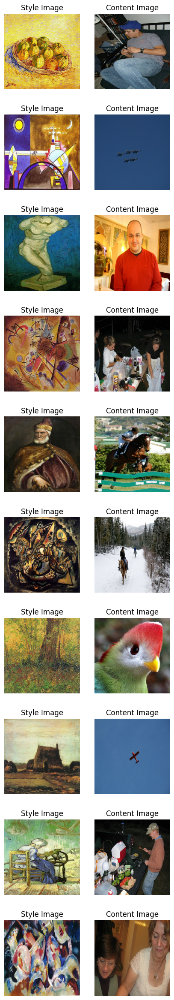

In [31]:
style, content = next(iter(train_ds))
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(5, 30))
[ax.axis("off") for ax in np.ravel(axes)]

for (axis, style_image, content_image) in zip(axes, style[0:10], content[0:10]):
    (ax_style, ax_content) = axis
    ax_style.imshow(style_image)
    ax_style.set_title("Style Image")

    ax_content.imshow(content_image)
    ax_content.set_title("Content Image")

### **Architecture**

The style transfer network works by taking in a content image and a style image as inputs. Then, it generates an image that combines the content of one with the artistic style of the other. The AdaIN method, suggested by its authors, uses a straightforward encoder-decoder structure to accomplish this transformation.


![AdaIN architecture](https://i.imgur.com/JbIfoyE.png)




$t=AdaIn(f_c,f_s)$

$T=g(t)$


The style feature map (fs) and the content feature map (fc) are fed to the AdaIN layer. This layer produced the combined feature map t. The function g represents the decoder (generator) network.

### **Encoder**

We're using a special part of a model called the encoder, which comes from a VGG19 model that was already trained on ImageNet. We're specifically selecting a portion of this model, starting from the 'block4-conv1' layer.

In [32]:

def get_encoder():
    vgg19 = keras.applications.VGG19(
        include_top=False,
        weights="imagenet",
        input_shape=(*IMAGE_SIZE, 3),
    )
    vgg19.trainable = False
    mini_vgg19 = keras.Model(vgg19.input, vgg19.get_layer("block4_conv1").output)

    inputs = layers.Input([*IMAGE_SIZE, 3])
    mini_vgg19_out = mini_vgg19(inputs)
    return keras.Model(inputs, mini_vgg19_out, name="mini_vgg19")


We're using a special layer called AdaIN that adjusts the features from both the content and style images. It makes sure that the characteristics, like the average and spread, of the content picture match those of the style images.


$AdaIn(x,y) = σ(y)(\frac{(x-μ(x)}{σ(x)}) + μ(y) $

This AdaIN layer doesn't use any complicated settings or learn anything new—it just aligns these characteristics. Because of this, we're using a simple Python function instead of a more complex Keras layer. This function calculates the average and spread of the images and then adjusts the features accordingly.

In [33]:

def get_mean_std(x, epsilon=1e-5):
    axes = [1, 2]

    # Compute the mean and standard deviation of a tensor.
    mean, variance = tf.nn.moments(x, axes=axes, keepdims=True)
    standard_deviation = tf.sqrt(variance + epsilon)
    return mean, standard_deviation


def ada_in(style, content):
    """Computes the AdaIn feature map.

    Args:
        style: The style feature map.
        content: The content feature map.

    Returns:
        The AdaIN feature map.
    """
    content_mean, content_std = get_mean_std(content)
    style_mean, style_std = get_mean_std(style)
    t = style_std * (content - content_mean) / content_std + style_mean
    return t


### **Decoder**

We're creating what's called a decoder, which should be like a mirror image of the encoder according to the authors' instructions. To build this, we've flipped and arranged the encoder's layers in reverse.

We're using something called UpSampling2D layers to make the feature maps larger and more detailed.

It's important to note that the authors advise against using certain normalization layers in the decoder. They showed that adding batch normalization or instance normalization actually makes the network perform worse.

Interestingly, this decoder part is the only section that we train during the whole process

In [34]:

def get_decoder():
    config = {"kernel_size": 3, "strides": 1, "padding": "same", "activation": "relu"}
    decoder = keras.Sequential(
        [
            layers.InputLayer((None, None, 512)),
            layers.Conv2D(filters=512, **config),
            layers.UpSampling2D(),
            layers.Conv2D(filters=256, **config),
            layers.Conv2D(filters=256, **config),
            layers.Conv2D(filters=256, **config),
            layers.Conv2D(filters=256, **config),
            layers.UpSampling2D(),
            layers.Conv2D(filters=128, **config),
            layers.Conv2D(filters=128, **config),
            layers.UpSampling2D(),
            layers.Conv2D(filters=64, **config),
            layers.Conv2D(
                filters=3,
                kernel_size=3,
                strides=1,
                padding="same",
                activation="sigmoid",
            ),
        ]
    )
    return decoder


### **Loss functions**

We're creating the loss functions for our neural style transfer model. To calculate this, we're using a pretrained VGG-19 network, but it's important to note that we're using it specifically for training the decoder network.

$L_t= L_c+ λ L_s$

The total loss, which we call 'Lt,' is made up of two parts: the content loss, denoted as 'Lc,' and the style loss, marked as 'Ls.' There's a term called lambda that we use to control how much style gets transferred to the final image

### **Content Loss**

We're calculating something called the Content Loss, which measures the difference between the features of the content image and the features of the image created through neural style transfer.

$ L_c= ‖f(g(t))-t‖_2$

Instead of using the original image's features as the target, the authors suggest using the output from a specific layer called AdaIN as the content target. This helps the training process to speed up and converge more quickly.

### **Style Loss**

Rather than using the more commonly used Gram Matrix, the authors propose to compute the difference between the statistical features (mean and variance) which makes it conceptually cleaner. This can be easily visualized via the following equation:

$ L_s= ∑^L_{ _{i=1}}‖μ(ϕ_i (g(t)))-μ(ϕ_i (s))‖_2 + ∑^L_{ _{i=1}}‖σ(ϕ_i (g(t)))-σ(ϕ_i (s))‖_2 $


where theta denotes the layers in VGG-19 used to compute the loss. In this case this corresponds to:

block1_conv1

block1_conv2

block1_conv3

block1_conv4

In [35]:

def get_loss_net():
    vgg19 = keras.applications.VGG19(
        include_top=False, weights="imagenet", input_shape=(*IMAGE_SIZE, 3)
    )
    vgg19.trainable = False
    layer_names = ["block1_conv1", "block2_conv1", "block3_conv1", "block4_conv1"]
    outputs = [vgg19.get_layer(name).output for name in layer_names]
    mini_vgg19 = keras.Model(vgg19.input, outputs)

    inputs = layers.Input([*IMAGE_SIZE, 3])
    mini_vgg19_out = mini_vgg19(inputs)
    return keras.Model(inputs, mini_vgg19_out, name="loss_net")


### **Style Transfering**

We're creating a trainer module for Neural Style Transfer. Here, we package the encoder and decoder into a special type of model using Tensorflow model subclass subclass. This lets us control and customize the training process within the model.fit() loop

In [36]:

class NeuralStyleTransfer(tf.keras.Model):
    def __init__(self, encoder, decoder, loss_net, style_weight, **kwargs):
        super().__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.loss_net = loss_net
        self.style_weight = style_weight

    def compile(self, optimizer, loss_fn):
        super().compile()
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.style_loss_tracker = keras.metrics.Mean(name="style_loss")
        self.content_loss_tracker = keras.metrics.Mean(name="content_loss")
        self.total_loss_tracker = keras.metrics.Mean(name="total_loss")

    def train_step(self, inputs):
        style, content = inputs

        # Initialize the content and style loss.
        loss_content = 0.0
        loss_style = 0.0

        with tf.GradientTape() as tape:
            # Encode the style and content image.
            style_encoded = self.encoder(style)
            content_encoded = self.encoder(content)

            # Compute the AdaIN target feature maps.
            t = ada_in(style=style_encoded, content=content_encoded)

            # Generate the neural style transferred image.
            reconstructed_image = self.decoder(t)

            # Compute the losses.
            reconstructed_vgg_features = self.loss_net(reconstructed_image)
            style_vgg_features = self.loss_net(style)
            loss_content = self.loss_fn(t, reconstructed_vgg_features[-1])
            for inp, out in zip(style_vgg_features, reconstructed_vgg_features):
                mean_inp, std_inp = get_mean_std(inp)
                mean_out, std_out = get_mean_std(out)
                loss_style += self.loss_fn(mean_inp, mean_out) + self.loss_fn(
                    std_inp, std_out
                )
            loss_style = self.style_weight * loss_style
            total_loss = loss_content + loss_style

        # Compute gradients and optimize the decoder.
        trainable_vars = self.decoder.trainable_variables
        gradients = tape.gradient(total_loss, trainable_vars)
        self.optimizer.apply_gradients(zip(gradients, trainable_vars))

        # Update the trackers.
        self.style_loss_tracker.update_state(loss_style)
        self.content_loss_tracker.update_state(loss_content)
        self.total_loss_tracker.update_state(total_loss)
        return {
            "style_loss": self.style_loss_tracker.result(),
            "content_loss": self.content_loss_tracker.result(),
            "total_loss": self.total_loss_tracker.result(),
        }

    def test_step(self, inputs):
        style, content = inputs

        # Initialize the content and style loss.
        loss_content = 0.0
        loss_style = 0.0

        # Encode the style and content image.
        style_encoded = self.encoder(style)
        content_encoded = self.encoder(content)

        # Compute the AdaIN target feature maps.
        t = ada_in(style=style_encoded, content=content_encoded)

        # Generate the neural style transferred image.
        reconstructed_image = self.decoder(t)

        # Compute the losses.
        recons_vgg_features = self.loss_net(reconstructed_image)
        style_vgg_features = self.loss_net(style)
        loss_content = self.loss_fn(t, recons_vgg_features[-1])
        for inp, out in zip(style_vgg_features, recons_vgg_features):
            mean_inp, std_inp = get_mean_std(inp)
            mean_out, std_out = get_mean_std(out)
            loss_style += self.loss_fn(mean_inp, mean_out) + self.loss_fn(
                std_inp, std_out
            )
        loss_style = self.style_weight * loss_style
        total_loss = loss_content + loss_style

        # Update the trackers.
        self.style_loss_tracker.update_state(loss_style)
        self.content_loss_tracker.update_state(loss_content)
        self.total_loss_tracker.update_state(total_loss)
        return {
            "style_loss": self.style_loss_tracker.result(),
            "content_loss": self.content_loss_tracker.result(),
            "total_loss": self.total_loss_tracker.result(),
        }

    @property
    def metrics(self):
        return [
            self.style_loss_tracker,
            self.content_loss_tracker,
            self.total_loss_tracker,
        ]


## Train Monitor callback

We've created a Train Monitor callback that helps us see the style transfer results of the model after each training cycle (epoch). Since the goal of style transfer is subjective and can't be measured precisely, visualizing the outputs is crucial for evaluating how well the model is performing

In [37]:
test_style, test_content = next(iter(test_ds))


class TrainMonitor(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        # Encode the style and content image.
        test_style_encoded = self.model.encoder(test_style)
        test_content_encoded = self.model.encoder(test_content)

        # Compute the AdaIN features.
        test_t = ada_in(style=test_style_encoded, content=test_content_encoded)
        test_reconstructed_image = self.model.decoder(test_t)

        # Plot the Style, Content and the NST image.
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))
        ax[0].imshow(tf.keras.utils.array_to_img(test_style[0]))
        ax[0].set_title(f"Style: {epoch:03d}")

        ax[1].imshow(tf.keras.utils.array_to_img(test_content[0]))
        ax[1].set_title(f"Content: {epoch:03d}")

        ax[2].imshow(
            tf.keras.utils.array_to_img(test_reconstructed_image[0])
        )
        ax[2].set_title(f"NST: {epoch:03d}")

        plt.show()
        plt.close()


### **Training the model**

We're getting the model ready for training in this part. We set up things like the optimizer, the loss function, and the trainer module. After combining them together, we start training the model.

Just a heads-up: due to time limitations, we're training the model for only one epoch. However, to get good results, we'll need to train it for at least 30 epochs

Epoch 1/30
50/50 [==============================] - ETA: 0s - style_loss: 215.6148 - content_loss: 137.3840 - total_loss: 352.9988

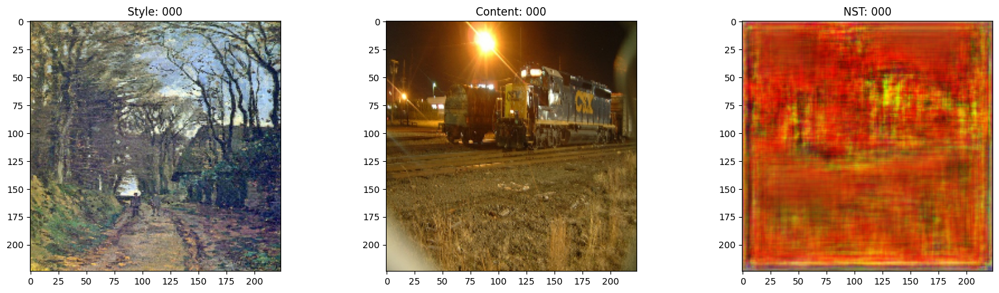

50/50 [==============================] - 102s 2s/step - style_loss: 215.6148 - content_loss: 137.3840 - total_loss: 352.9988 - val_style_loss: 178.6065 - val_content_loss: 136.3606 - val_total_loss: 314.9671
Epoch 2/30
50/50 [==============================] - ETA: 0s - style_loss: 162.7610 - content_loss: 126.9676 - total_loss: 289.7286

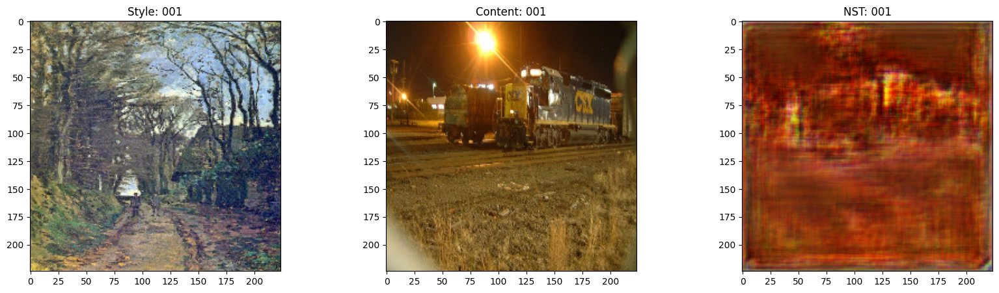

50/50 [==============================] - 95s 2s/step - style_loss: 162.7610 - content_loss: 126.9676 - total_loss: 289.7286 - val_style_loss: 148.1245 - val_content_loss: 118.5286 - val_total_loss: 266.6532
Epoch 3/30
50/50 [==============================] - ETA: 0s - style_loss: 152.0500 - content_loss: 129.4005 - total_loss: 281.4505

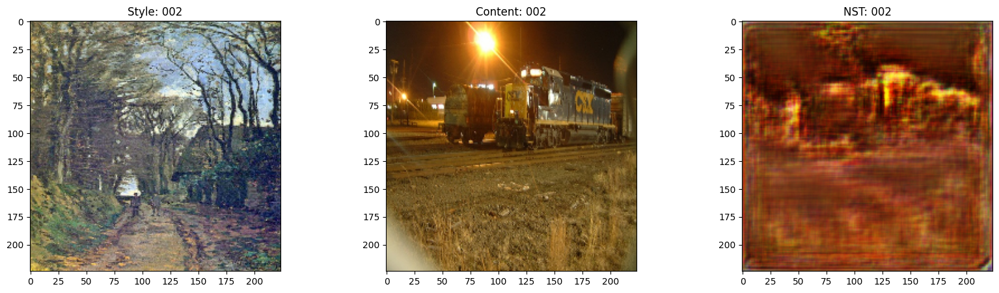

50/50 [==============================] - 102s 2s/step - style_loss: 152.0500 - content_loss: 129.4005 - total_loss: 281.4505 - val_style_loss: 120.5165 - val_content_loss: 110.2700 - val_total_loss: 230.7865
Epoch 4/30
50/50 [==============================] - ETA: 0s - style_loss: 111.9168 - content_loss: 111.9060 - total_loss: 223.8228

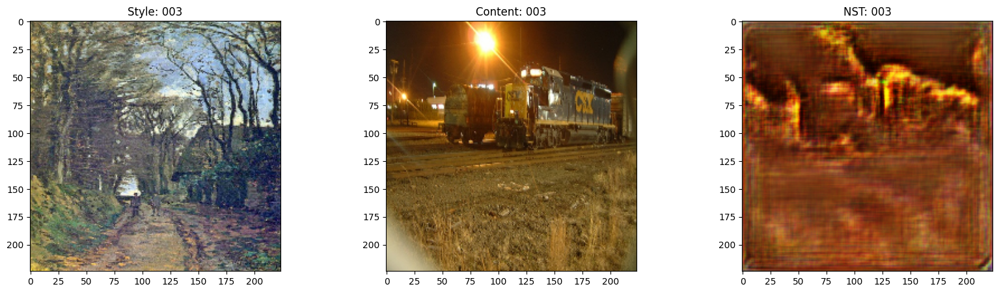

50/50 [==============================] - 92s 2s/step - style_loss: 111.9168 - content_loss: 111.9060 - total_loss: 223.8228 - val_style_loss: 104.3930 - val_content_loss: 102.9708 - val_total_loss: 207.3637
Epoch 5/30
50/50 [==============================] - ETA: 0s - style_loss: 103.9981 - content_loss: 99.9741 - total_loss: 203.9722 

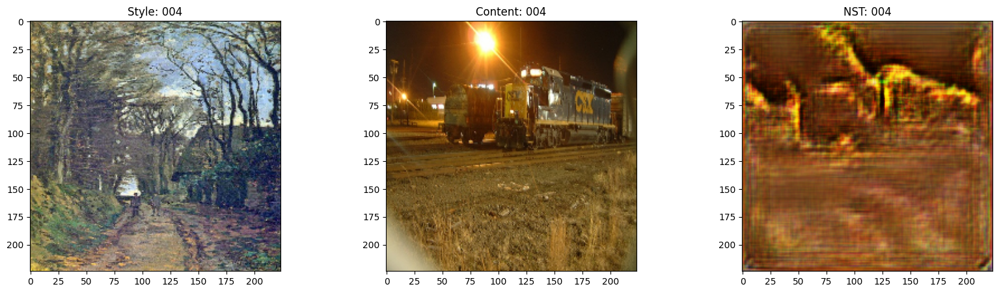

50/50 [==============================] - 102s 2s/step - style_loss: 103.9981 - content_loss: 99.9741 - total_loss: 203.9722 - val_style_loss: 92.0986 - val_content_loss: 98.6084 - val_total_loss: 190.7070
Epoch 6/30
50/50 [==============================] - ETA: 0s - style_loss: 74.4197 - content_loss: 88.2238 - total_loss: 162.6434

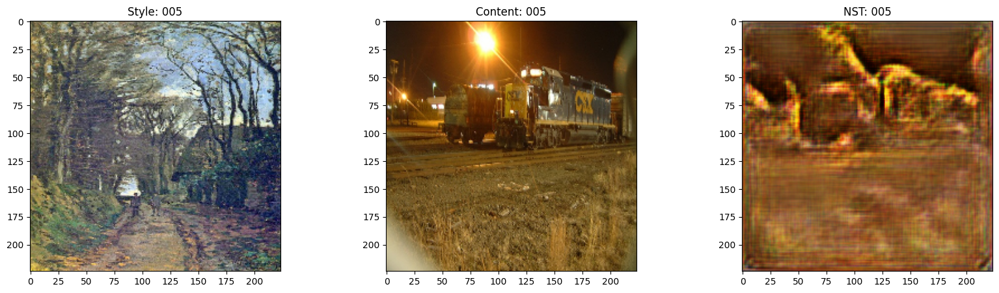

50/50 [==============================] - 103s 2s/step - style_loss: 74.4197 - content_loss: 88.2238 - total_loss: 162.6434 - val_style_loss: 87.0142 - val_content_loss: 94.5657 - val_total_loss: 181.5799
Epoch 7/30
50/50 [==============================] - ETA: 0s - style_loss: 91.9880 - content_loss: 100.5583 - total_loss: 192.5464

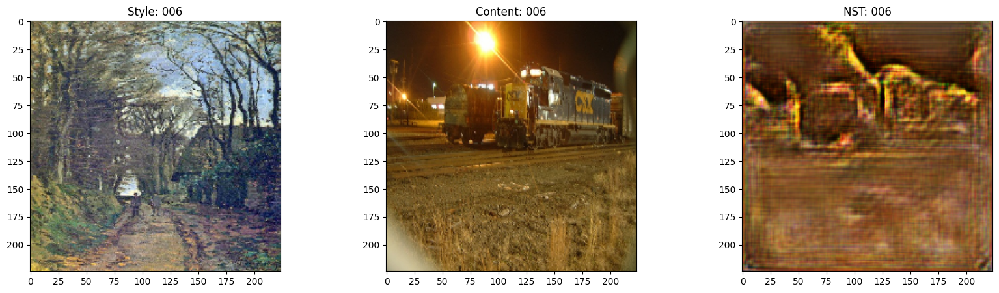

50/50 [==============================] - 92s 2s/step - style_loss: 91.9880 - content_loss: 100.5583 - total_loss: 192.5464 - val_style_loss: 78.6173 - val_content_loss: 91.0667 - val_total_loss: 169.6840
Epoch 8/30
50/50 [==============================] - ETA: 0s - style_loss: 95.0039 - content_loss: 101.1874 - total_loss: 196.1913

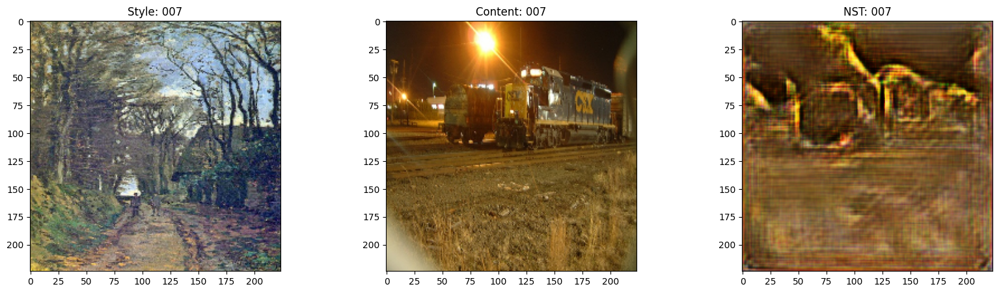

50/50 [==============================] - 104s 2s/step - style_loss: 95.0039 - content_loss: 101.1874 - total_loss: 196.1913 - val_style_loss: 72.8569 - val_content_loss: 89.3759 - val_total_loss: 162.2329
Epoch 9/30
50/50 [==============================] - ETA: 0s - style_loss: 66.7588 - content_loss: 85.1899 - total_loss: 151.9487

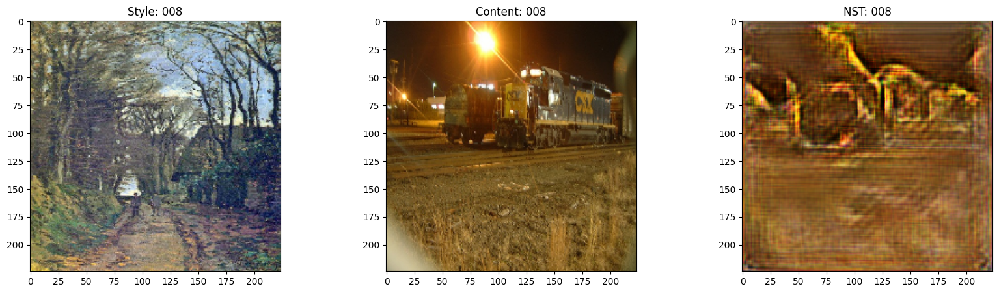

50/50 [==============================] - 93s 2s/step - style_loss: 66.7588 - content_loss: 85.1899 - total_loss: 151.9487 - val_style_loss: 68.9896 - val_content_loss: 85.1661 - val_total_loss: 154.1557
Epoch 10/30
50/50 [==============================] - ETA: 0s - style_loss: 60.1952 - content_loss: 77.2822 - total_loss: 137.4774

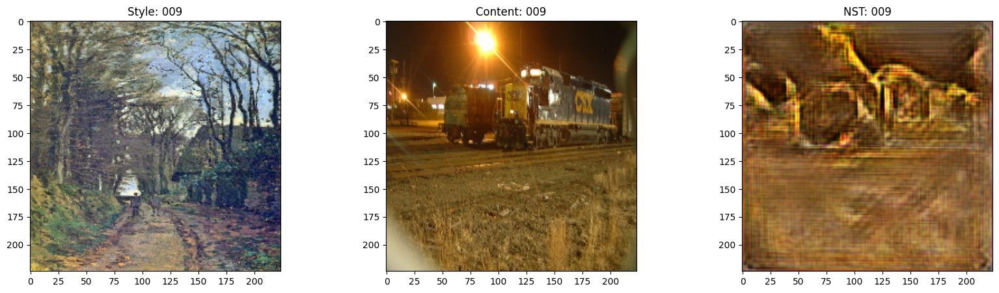

50/50 [==============================] - 102s 2s/step - style_loss: 60.1952 - content_loss: 77.2822 - total_loss: 137.4774 - val_style_loss: 66.5404 - val_content_loss: 82.8927 - val_total_loss: 149.4331
Epoch 11/30
50/50 [==============================] - ETA: 0s - style_loss: 69.7988 - content_loss: 85.0656 - total_loss: 154.8644

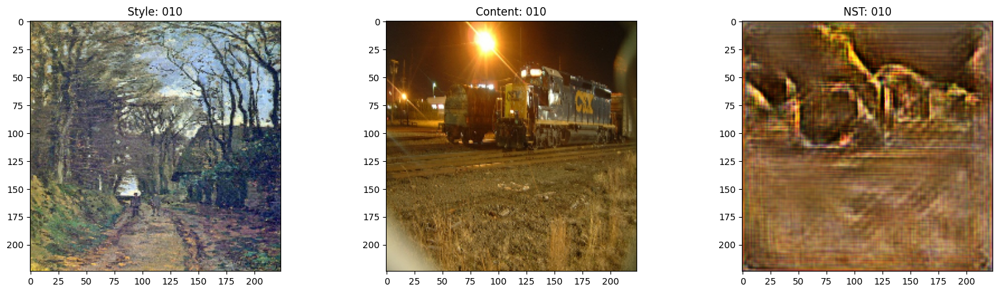

50/50 [==============================] - 102s 2s/step - style_loss: 69.7988 - content_loss: 85.0656 - total_loss: 154.8644 - val_style_loss: 62.9905 - val_content_loss: 80.3041 - val_total_loss: 143.2947
Epoch 12/30
50/50 [==============================] - ETA: 0s - style_loss: 74.3300 - content_loss: 88.1211 - total_loss: 162.4512

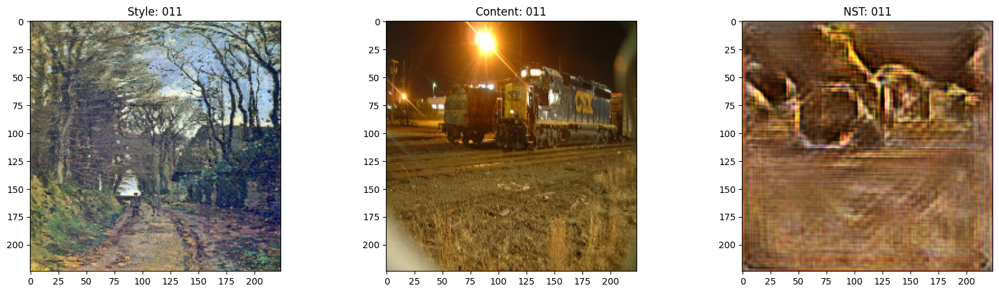

50/50 [==============================] - 94s 2s/step - style_loss: 74.3300 - content_loss: 88.1211 - total_loss: 162.4512 - val_style_loss: 58.8594 - val_content_loss: 79.0484 - val_total_loss: 137.9079
Epoch 13/30
50/50 [==============================] - ETA: 0s - style_loss: 49.5844 - content_loss: 76.4551 - total_loss: 126.0394

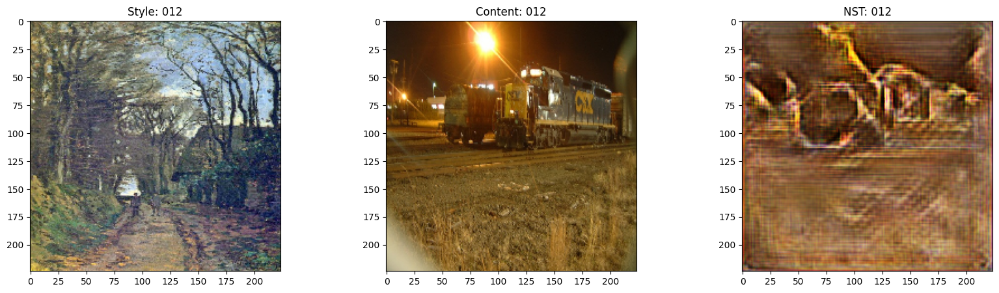

50/50 [==============================] - 102s 2s/step - style_loss: 49.5844 - content_loss: 76.4551 - total_loss: 126.0394 - val_style_loss: 57.1401 - val_content_loss: 77.2340 - val_total_loss: 134.3741
Epoch 14/30
50/50 [==============================] - ETA: 0s - style_loss: 57.1223 - content_loss: 73.2236 - total_loss: 130.3459

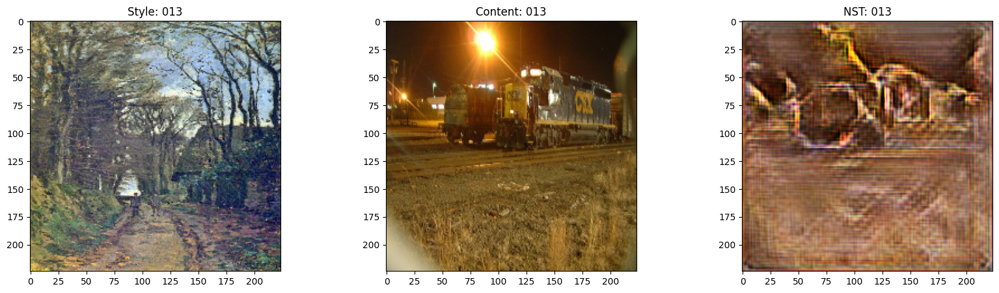

50/50 [==============================] - 92s 2s/step - style_loss: 57.1223 - content_loss: 73.2236 - total_loss: 130.3459 - val_style_loss: 55.5123 - val_content_loss: 76.0808 - val_total_loss: 131.5932
Epoch 15/30
50/50 [==============================] - ETA: 0s - style_loss: 52.4176 - content_loss: 74.0511 - total_loss: 126.4688

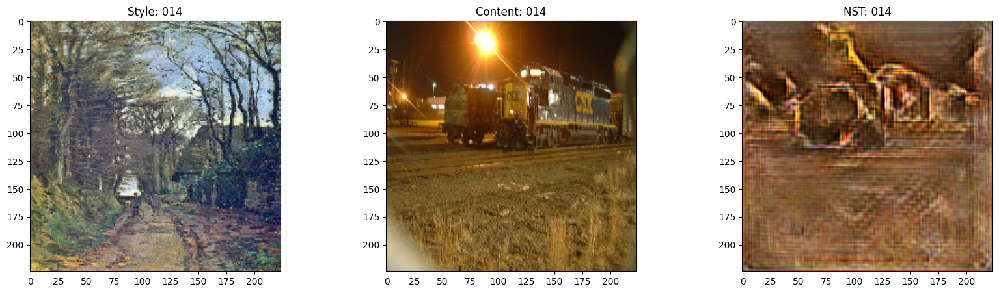

50/50 [==============================] - 92s 2s/step - style_loss: 52.4176 - content_loss: 74.0511 - total_loss: 126.4688 - val_style_loss: 54.4029 - val_content_loss: 72.7485 - val_total_loss: 127.1514
Epoch 16/30
50/50 [==============================] - ETA: 0s - style_loss: 63.0772 - content_loss: 81.8382 - total_loss: 144.9154

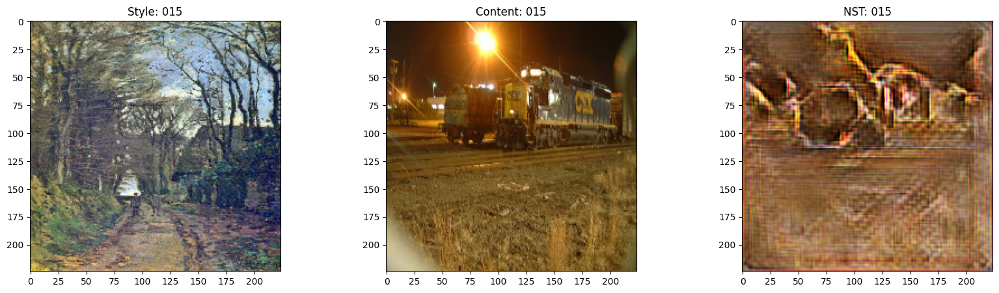

50/50 [==============================] - 101s 2s/step - style_loss: 63.0772 - content_loss: 81.8382 - total_loss: 144.9154 - val_style_loss: 50.6639 - val_content_loss: 72.8583 - val_total_loss: 123.5222
Epoch 17/30
50/50 [==============================] - ETA: 0s - style_loss: 52.5089 - content_loss: 75.8114 - total_loss: 128.3203

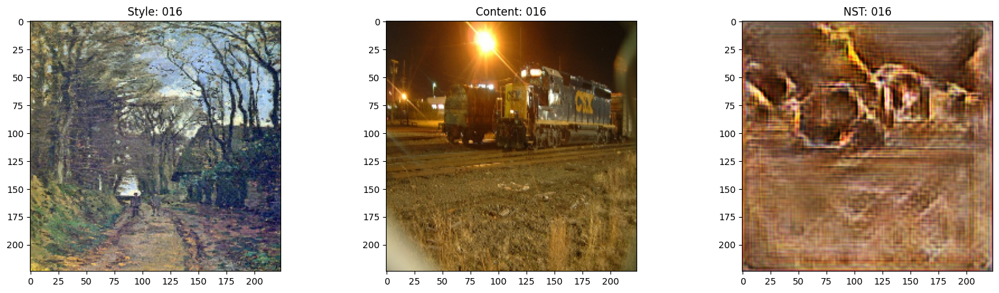

50/50 [==============================] - 92s 2s/step - style_loss: 52.5089 - content_loss: 75.8114 - total_loss: 128.3203 - val_style_loss: 49.2298 - val_content_loss: 71.9534 - val_total_loss: 121.1832
Epoch 18/30
50/50 [==============================] - ETA: 0s - style_loss: 46.7204 - content_loss: 69.8759 - total_loss: 116.5963

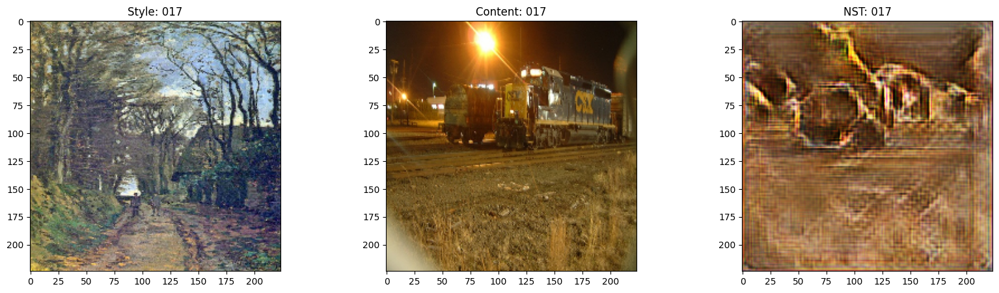

50/50 [==============================] - 101s 2s/step - style_loss: 46.7204 - content_loss: 69.8759 - total_loss: 116.5963 - val_style_loss: 48.8782 - val_content_loss: 69.9483 - val_total_loss: 118.8265
Epoch 19/30
50/50 [==============================] - ETA: 0s - style_loss: 38.8558 - content_loss: 63.0420 - total_loss: 101.8978

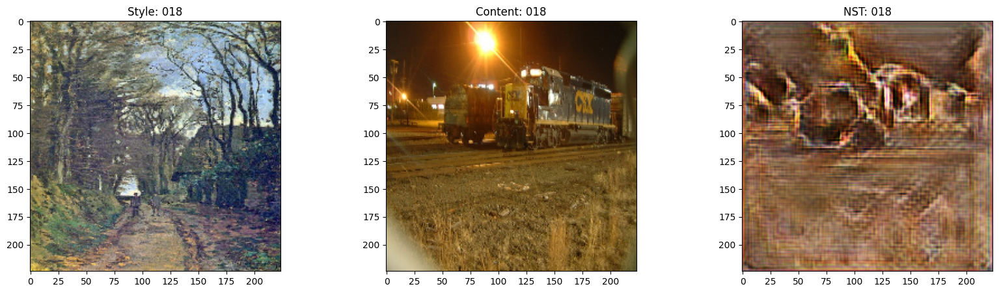

50/50 [==============================] - 102s 2s/step - style_loss: 38.8558 - content_loss: 63.0420 - total_loss: 101.8978 - val_style_loss: 48.2570 - val_content_loss: 68.9685 - val_total_loss: 117.2256
Epoch 20/30
50/50 [==============================] - ETA: 0s - style_loss: 51.7069 - content_loss: 73.8977 - total_loss: 125.6047

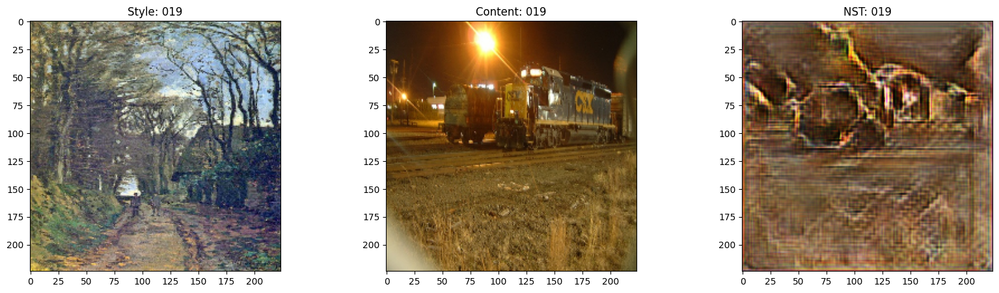

50/50 [==============================] - 102s 2s/step - style_loss: 51.7069 - content_loss: 73.8977 - total_loss: 125.6047 - val_style_loss: 47.0484 - val_content_loss: 68.0575 - val_total_loss: 115.1059
Epoch 21/30
50/50 [==============================] - ETA: 0s - style_loss: 57.0977 - content_loss: 76.1056 - total_loss: 133.2034

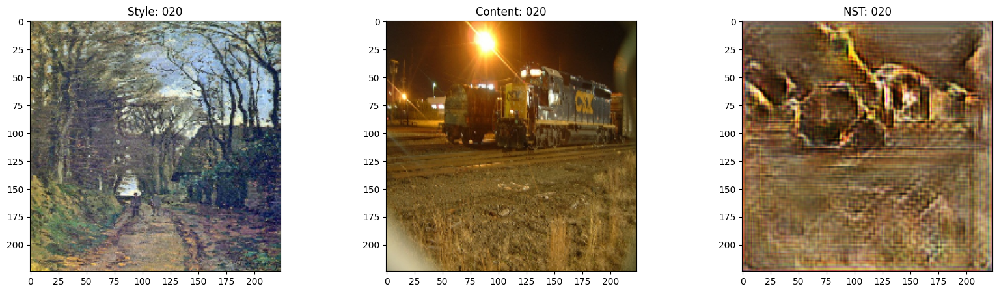

50/50 [==============================] - 102s 2s/step - style_loss: 57.0977 - content_loss: 76.1056 - total_loss: 133.2034 - val_style_loss: 44.1571 - val_content_loss: 67.8840 - val_total_loss: 112.0410
Epoch 22/30
50/50 [==============================] - ETA: 0s - style_loss: 37.8629 - content_loss: 65.4197 - total_loss: 103.2827

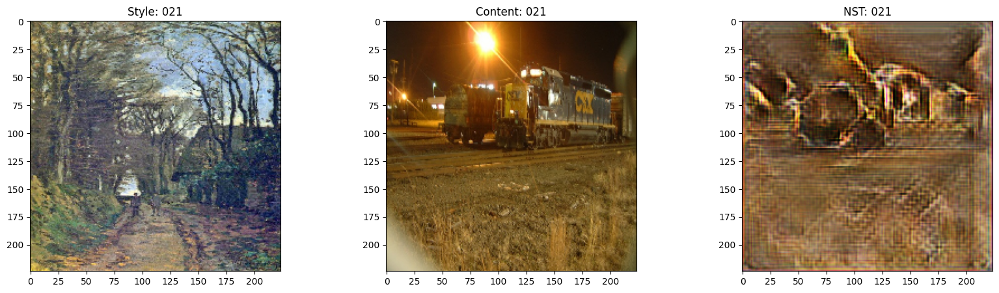

50/50 [==============================] - 92s 2s/step - style_loss: 37.8629 - content_loss: 65.4197 - total_loss: 103.2827 - val_style_loss: 43.6284 - val_content_loss: 66.0824 - val_total_loss: 109.7107
Epoch 23/30
50/50 [==============================] - ETA: 0s - style_loss: 36.2901 - content_loss: 59.8439 - total_loss: 96.1340

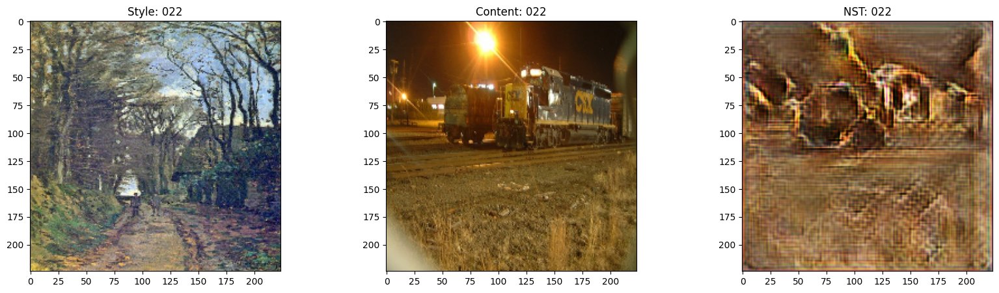

50/50 [==============================] - 101s 2s/step - style_loss: 36.2901 - content_loss: 59.8439 - total_loss: 96.1340 - val_style_loss: 42.7412 - val_content_loss: 64.6866 - val_total_loss: 107.4278
Epoch 24/30
50/50 [==============================] - ETA: 0s - style_loss: 44.6486 - content_loss: 68.1466 - total_loss: 112.7952

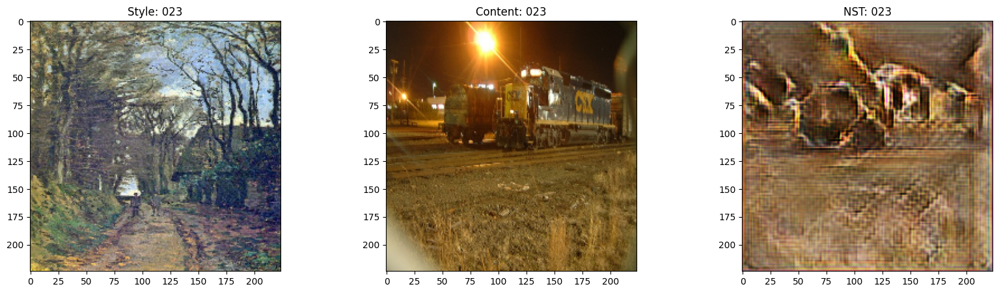

50/50 [==============================] - 92s 2s/step - style_loss: 44.6486 - content_loss: 68.1466 - total_loss: 112.7952 - val_style_loss: 41.5712 - val_content_loss: 65.1099 - val_total_loss: 106.6811
Epoch 25/30
50/50 [==============================] - ETA: 0s - style_loss: 49.2008 - content_loss: 70.1676 - total_loss: 119.3684

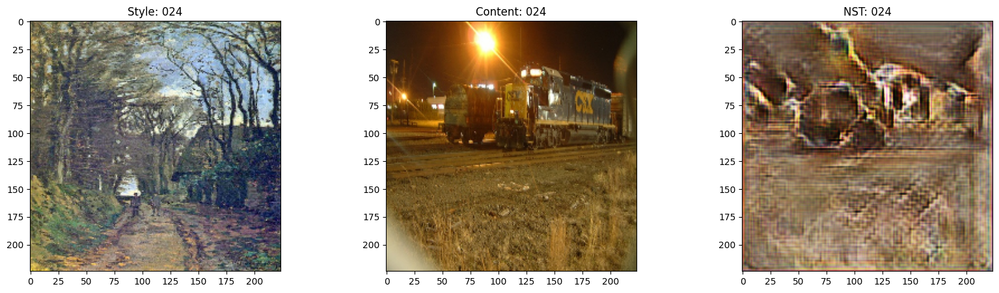

50/50 [==============================] - 101s 2s/step - style_loss: 49.2008 - content_loss: 70.1676 - total_loss: 119.3684 - val_style_loss: 41.2739 - val_content_loss: 64.2236 - val_total_loss: 105.4975
Epoch 26/30
50/50 [==============================] - ETA: 0s - style_loss: 33.5128 - content_loss: 62.7044 - total_loss: 96.2173

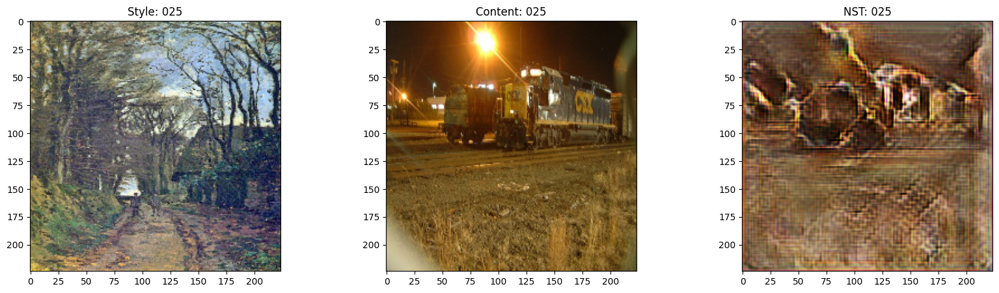

50/50 [==============================] - 102s 2s/step - style_loss: 33.5128 - content_loss: 62.7044 - total_loss: 96.2173 - val_style_loss: 40.0699 - val_content_loss: 62.4554 - val_total_loss: 102.5253
Epoch 27/30
50/50 [==============================] - ETA: 0s - style_loss: 36.7504 - content_loss: 60.0410 - total_loss: 96.7914

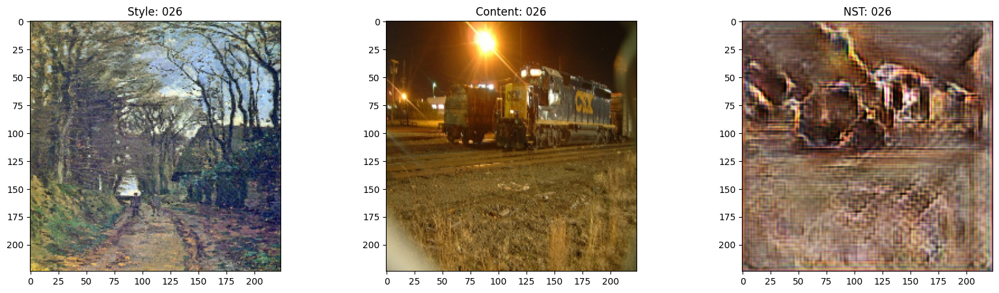

50/50 [==============================] - 93s 2s/step - style_loss: 36.7504 - content_loss: 60.0410 - total_loss: 96.7914 - val_style_loss: 39.3861 - val_content_loss: 62.3056 - val_total_loss: 101.6916
Epoch 28/30
50/50 [==============================] - ETA: 0s - style_loss: 35.7178 - content_loss: 61.2472 - total_loss: 96.9650

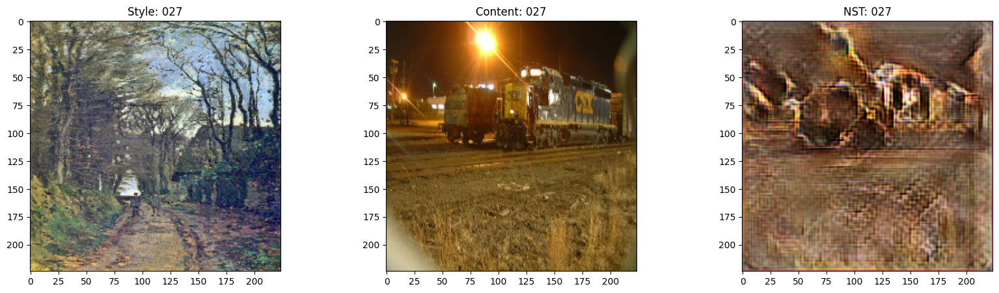

50/50 [==============================] - 101s 2s/step - style_loss: 35.7178 - content_loss: 61.2472 - total_loss: 96.9650 - val_style_loss: 39.4041 - val_content_loss: 61.2057 - val_total_loss: 100.6097
Epoch 29/30
50/50 [==============================] - ETA: 0s - style_loss: 44.2476 - content_loss: 68.3739 - total_loss: 112.6215

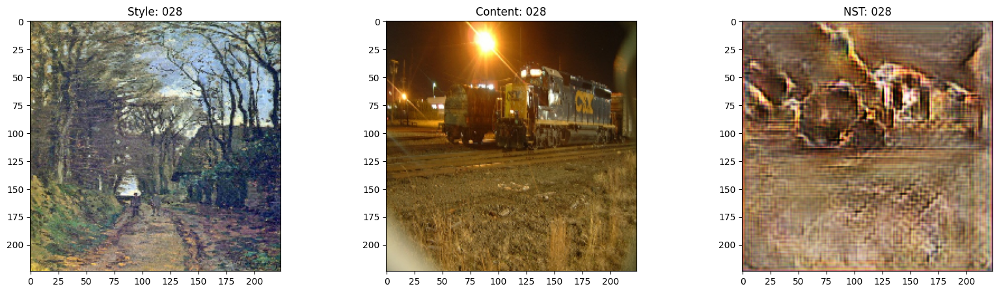

50/50 [==============================] - 102s 2s/step - style_loss: 44.2476 - content_loss: 68.3739 - total_loss: 112.6215 - val_style_loss: 37.1655 - val_content_loss: 61.5114 - val_total_loss: 98.6769
Epoch 30/30
50/50 [==============================] - ETA: 0s - style_loss: 38.1088 - content_loss: 64.4631 - total_loss: 102.5720

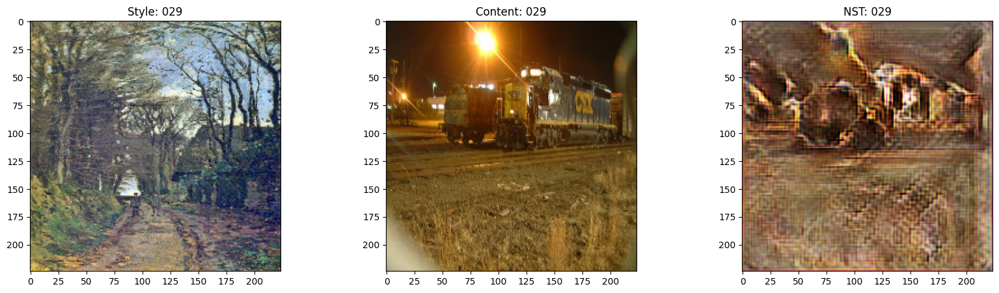

50/50 [==============================] - 97s 2s/step - style_loss: 38.1088 - content_loss: 64.4631 - total_loss: 102.5720 - val_style_loss: 36.7530 - val_content_loss: 60.4249 - val_total_loss: 97.1780


In [40]:
optimizer = keras.optimizers.Adam(learning_rate=1e-5)
loss_fn = keras.losses.MeanSquaredError()

encoder = get_encoder()
loss_net = get_loss_net()
decoder = get_decoder()

model = NeuralStyleTransfer(
    encoder=encoder, decoder=decoder, loss_net=loss_net, style_weight=4.0
)

model.compile(optimizer=optimizer, loss_fn=loss_fn)

history = model.fit(
    train_ds,
    epochs=EPOCHS,
    steps_per_epoch=50,
    validation_data=val_ds,
    validation_steps=50,
    callbacks=[TrainMonitor()],
)

## Inference

Checking the output images for content and style images from test dataset

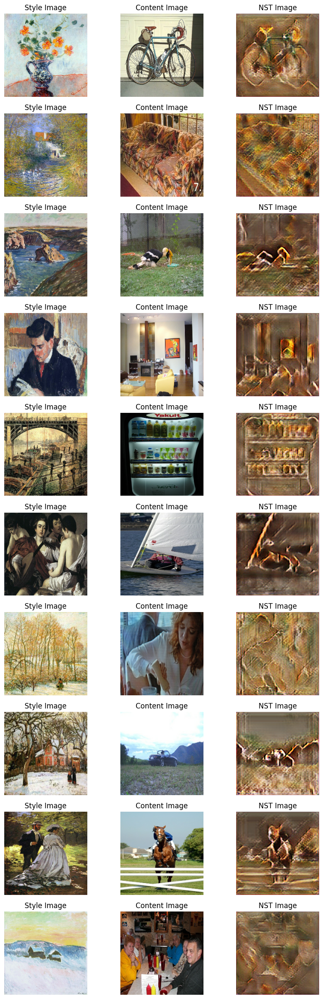

In [41]:
for style, content in test_ds.take(1):
    style_encoded = model.encoder(style)
    content_encoded = model.encoder(content)
    t = ada_in(style=style_encoded, content=content_encoded)
    reconstructed_image = model.decoder(t)
    fig, axes = plt.subplots(nrows=10, ncols=3, figsize=(10, 30))
    [ax.axis("off") for ax in np.ravel(axes)]

    for axis, style_image, content_image, reconstructed_image in zip(
        axes, style[0:10], content[0:10], reconstructed_image[0:10]
    ):
        (ax_style, ax_content, ax_reconstructed) = axis
        ax_style.imshow(style_image)
        ax_style.set_title("Style Image")
        ax_content.imshow(content_image)
        ax_content.set_title("Content Image")
        ax_reconstructed.imshow(reconstructed_image)
        ax_reconstructed.set_title("NST Image")

## **Limitations:-**


1. Model trained in VGG-19, can be improved to much better models like GAN, GNN based neural style transfer etc.
2. In this implementation, adaptive normalisation has been used which is better than other normalisations.
3. Evaluative measures in content based and style based loss can be improved too.













